## Setup

In [9]:
import os
import matplotlib.pyplot as plt
import numpy as np
from vision_agent.tools import *
from typing import *
from pillow_heif import register_heif_opener
register_heif_opener()
import vision_agent as va
from vision_agent.tools import register_tool

import numpy as np
import cv2
from vision_agent.tools import load_image, owl_v2_image, depth_anything_v2, overlay_bounding_boxes


## Function

In [13]:

def detect_road_defects(image_path):
    # Load the image
    image = load_image(image_path)
    height, width = image.shape[:2]

    # Detect road surface defects
    defects = owl_v2_image('road surface cracks, road surface holes, road surface potholes', image, box_threshold=0.2)

    # Get depth information
    depth_map = depth_anything_v2(image)

    # Initialize separate masks for each defect type
    crack_mask = np.zeros((height, width), dtype=np.uint8)
    hole_mask = np.zeros((height, width), dtype=np.uint8)
    pothole_mask = np.zeros((height, width), dtype=np.uint8)

    bboxes = []

    for defect in defects:
        x1, y1, x2, y2 = [int(coord * dim) for coord, dim in zip(defect['bbox'], [width, height, width, height])]
        
        # Analyze depth in the defect area
        depth_roi = depth_map[y1:y2, x1:x2]
        depth_variance = np.var(depth_roi)
        avg_depth = np.mean(depth_roi)

        # Initialize label with the original detection label
        label = defect['label']

        # Classify defect based on detection label and depth analysis
        if defect['label'] == 'road surface cracks':
            if depth_variance < 70:  # Cracks typically have low depth variance
                crack_mask[y1:y2, x1:x2] = 255
                label = 'Crack'
        elif defect['label'] == 'road surface holes':
            if 70 <= depth_variance < 100 and avg_depth > 100:  # Holes have moderate depth variance and are deeper
                hole_mask[y1:y2, x1:x2] = 255
                label = 'Hole'
        elif defect['label'] == 'road surface potholes':
            if depth_variance >= 100 and avg_depth > 150:  # Potholes have high depth variance and are deepest
                pothole_mask[y1:y2, x1:x2] = 255
                label = 'Pothole'

        bboxes.append({'bbox': defect['bbox'], 'label': label, 'score': defect['score']})

    # Refine masks using morphological operations
    kernel = np.ones((5,5), np.uint8)
    crack_mask = cv2.morphologyEx(crack_mask, cv2.MORPH_CLOSE, kernel)
    hole_mask = cv2.morphologyEx(hole_mask, cv2.MORPH_CLOSE, kernel)
    pothole_mask = cv2.morphologyEx(pothole_mask, cv2.MORPH_CLOSE, kernel)

    # Create color-coded overlay for different defect types
    overlay = image.copy()
    overlay[crack_mask == 255] = [255, 0, 0]  # Blue for cracks
    overlay[hole_mask == 255] = [0, 255, 0]   # Green for holes
    overlay[pothole_mask == 255] = [0, 0, 255]  # Red for potholes

    # Overlay the bounding boxes on the original image
    result_image = overlay_bounding_boxes(image, bboxes)

    # Combine the original image with the color-coded overlay
    result_image = cv2.addWeighted(result_image, 0.7, overlay, 0.3, 0)

    return {
        'crack_mask': crack_mask,
        'hole_mask': hole_mask,
        'pothole_mask': pothole_mask,
        'result_image': result_image
    }

## Run code

Find images [here](https://github.com/biankatpas/Cracks-and-Potholes-in-Road-Images-Dataset/blob/master/Dataset/1014753_RS_386_386RS124739_30690/1014753_RS_386_386RS124739_30690_RAW.jpg)

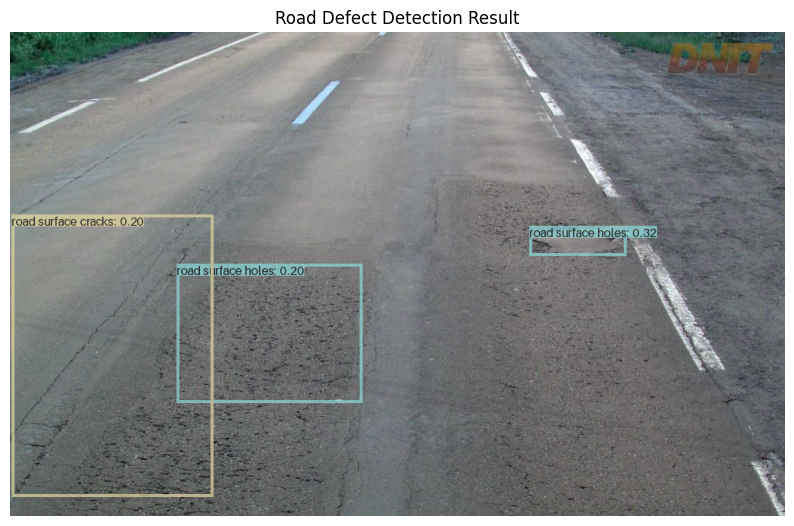

In [15]:
# Path to your image
image_path = 'RAW2.jpg'

# Call the function to detect road defects
results = detect_road_defects(image_path)

# Extract the result image
result_image = results['result_image']

# Convert BGR to RGB for displaying in matplotlib
result_image_rgb = cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB)

# Display the result image
plt.figure(figsize=(10, 10))
plt.imshow(result_image_rgb)
plt.axis('off')  # Turn off axes
plt.title('Road Defect Detection Result')
plt.show()